# Data Preparation and Aggregation:

Imported Modules:

In [1]:
import numpy as np
import pandas as pd
import folium
import gmaps
from shapely.geometry import Polygon, MultiLineString, Point
from shapely import speedups
speedups.enable()
import shapely.wkt
from folium import plugins
from folium.plugins import HeatMap
from folium import IFrame
import geopandas
import plotly.express as px
import branca.colormap as cm
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

Creation of Base Map and City Boundaries Layer:

In [2]:
map_object = folium.Map(location = (51.0443, -114.0631), zoom_start=10) #Centered on Calgary Tower
all_grids_layer = folium.map.FeatureGroup(name = 'Grid Areas')

# Map style options
style = {'fillOpacity': 0.1}
style2 = {'fillOpacity': 0.1, 'fillColor': 'yellow', 'color': 'red'}
style3 = {'fillOpacity': 0, 'fillColor': 'yellow', 'color': 'red'}

# City boundaries layer
df_city_bounds = pd.read_csv('City_Boundary_layer.csv')
g = df_city_bounds['the_geom'].loc[0]
p = shapely.wkt.loads(g)
geom = Polygon(p)

outer_bounds = folium.GeoJson(geom,style_function=lambda x: style, name='City Boundaries', show = False).add_to(map_object)
popup = folium.Popup('These are the official boundaries of the City of Calgary')
popup.add_to(outer_bounds)

corners = geom.bounds

Making Outer Map Grid:

In [3]:
# Outer grid
bottom_left = (corners[0],corners[1]) #-114, 51
bottom_right = (corners[2],corners[1])
top_left = (corners[0],corners[3])
top_right = (corners[2],corners[3])

outer_grid_string = "POLYGON ((" + str(bottom_left[0]) + " " + str(bottom_left[1]) + "," + str(bottom_right[0]) + " " \
                    + str(bottom_right[1]) + "," + str(top_right[0]) + " " + str(top_right[1]) + "," + str(top_left[0])\
                    + " " + str(top_left[1]) + "," + str(bottom_left[0]) + " " + str(bottom_left[1]) + "))"


outer_grid_obj = shapely.wkt.loads(outer_grid_string)
outer_grid = Polygon(outer_grid_obj)

grid_layer = folium.GeoJson(outer_grid,style_function=lambda x: style2, name='Outer Grid Boundary', show = True).add_to(all_grids_layer)


# Separate space into each grid area
grid_columns = np.linspace(bottom_left[0], bottom_right[0], num = 11)
grid_rows = np.linspace(bottom_right[1], top_right[1], num = 11)


Making 100 Grid Areas for Map:

In [4]:
# Creating dictionary with grid square polygon objects
count = 1
grid_box_dict = {}

for i in range(len(grid_columns) - 1):
    for j in range(len(grid_rows) - 1):
        bottom_left = (grid_columns[i],grid_rows[j]) 
        bottom_right = (grid_columns[i+1],grid_rows[j])
        top_left = (grid_columns[i],grid_rows[j+1])
        top_right = (grid_columns[i+1],grid_rows[j+1])

        grid_box_string = "POLYGON ((" + str(bottom_left[0]) + " " + str(bottom_left[1]) + ", " + str(bottom_right[0]) + " " \
                            + str(bottom_right[1]) + ", " + str(top_right[0]) + " " + str(top_right[1]) + ", " + str(top_left[0])\
                            + " " + str(top_left[1]) + ", " + str(bottom_left[0]) + " " + str(bottom_left[1]) + "))"


        grid_box_obj = shapely.wkt.loads(grid_box_string)
        grid_box = Polygon(grid_box_obj)
        
        grid_box_dict[count-1]=grid_box
        count += 1

Reading Feature Data:

In [5]:
# Speed Limit Data
df_speed_limits = pd.read_csv('Speed_Limits.csv')
df_speed_limits_2 = df_speed_limits.copy()
compute_average_speed_using_points = True # If false, average is speed limit of each road crossing grid area/number of roads

# Traffic Volume Data
df_traffic_volume = pd.read_csv('Traffic_Volumes_for_2018.csv')
df_traffic_volume = df_traffic_volume[df_traffic_volume.YEAR == 2018].reset_index() # Only take data for 2018
compute_average_volume_using_points = True # If false, average is volume of each segment crossing grid area/number of segments

# Traffic Cameras Data
df_cameras = pd.read_csv('Traffic_Camera_Locations.csv')

# Traffic Signals Data
df_signals = pd.read_csv('Traffic_Signals.csv')

# Traffic Signs Data
df_signs = pd.read_csv('Traffic_Signs.csv')

# Traffic Accidents Data
df_accidents = pd.read_csv('Traffic_Incidents.csv')
df_accidents = df_accidents[df_accidents['START_DT'].str.contains('/2018 ')].reset_index() # Only take data for 2018
df_accidents_2 = df_accidents.copy()

Drawing Speed Limit Visualization:

In [6]:
def get_color_val(speed):
    """This function returns color corresponding to road speed"""
    if speed == 60:
        color_val = '#FEB24C'
    elif speed == 70:
        color_val = '#FD9244'
    elif speed == 80:
        color_val = '#FC4E2A'
    elif speed == 40:
        color_val = '#FED976'
    elif speed == 30:
        color_val = '#FFEEA4'
    elif speed == 100:
        color_val = '#BD0026'
    elif speed == 90:
        color_val = '#E31A1C'
    elif speed == 110:
        color_val = '#800026'
    elif speed == 35:
        color_val = '#FFEDA0'
    elif speed == 45:
        color_val = '#FFF8E6'
    elif speed == 20:
        color_val = '#FFFFCC'
    else:
        color_val = 'blue'
    return color_val

In [7]:
def plot_multiple_roads(first_stage):
    """This function is used to draw roads
        described by nested linestrings
    """
    first_stage = first_stage.split('(')
    for c in range(len(first_stage)):
        first_stage[c] = first_stage[c].replace("(","").replace(")","")
        second_stage = first_stage[c].split(" ")

        latitudes = []
        longitudes = []
        longitudes_corrected = []

        for i in range(len(second_stage)):
            if i % 2 ==0: # Even entries are longitudes in given files
                longitudes.append(second_stage[i])
            if i % 2 != 0:
                latitudes.append(second_stage[i])

        for i in range(len(latitudes)): 
            latitudes[i] = float(latitudes[i])

        for i in range(len(longitudes)):
            if len(longitudes[i]) > 0:
                longitudes_corrected.append(float(longitudes[i]))

        coords = list(zip(latitudes,longitudes_corrected))

        tool_tip_text = "Speed: " + str(speed) + "km/h  Street Name: " + str(street_name)

        my_polyline = folium.PolyLine(locations = coords, weight = 4, tooltip= tool_tip_text, color = color_val)
        speed_layer.add_child(my_polyline)

In [8]:
def plot_roads(first_stage):
    """This function is used to draw roads
        described by a simple multistring
    """
    second_stage = first_stage.split(" ")

    latitudes = []
    longitudes = []

    for i in range(len(second_stage)):
        if i % 2 ==0: # Even entries are longitudes in given files
            longitudes.append(second_stage[i])
        if i % 2 != 0:
            latitudes.append(second_stage[i])

    for i in range(len(latitudes)):
        latitudes[i] = float(latitudes[i])

    for i in range(len(longitudes)):
        longitudes[i] = float(longitudes[i])

    coords = list(zip(latitudes,longitudes))

    tool_tip_text = "Speed: " + str(speed) + "km/h  Street Name: " + str(street_name)

    my_polyline = folium.PolyLine(locations = coords, weight = 4, tooltip= tool_tip_text, color = color_val)
    speed_layer.add_child(my_polyline)

In [9]:
# Drawing Speed Limit Visualization
speed_layer = folium.map.FeatureGroup(name = 'Road Speed Limits', show = False)
for i in range(len(df_speed_limits_2)):
    speed = df_speed_limits_2['SPEED'][i]
    street_name = df_speed_limits_2['STREET_NAME'][i]
    
    color_val = get_color_val(speed)
    
    if "MULTILINE" in df_speed_limits_2['multiline'][i]:
        first_stage = df_speed_limits_2['multiline'][i].replace("MULTILINESTRING ((", "").replace("))","").replace(",","")
        if "(" in first_stage:
            plot_multiple_roads(first_stage)
        else:
            plot_roads(first_stage)

Creating DataFrame for All Grid Squares:

In [10]:
# Creating grid square dataframe        
grid_box_df = pd.DataFrame.from_dict(grid_box_dict, orient = 'index')
grid_box_df.columns = ['Polygon Object']
df_grid_polygons = grid_box_df['Polygon Object']       
geo_df_grid_polygons = geopandas.GeoDataFrame(df_grid_polygons, geometry = 'Polygon Object')


grid_box_df['Grid Coordinates'] = grid_box_df['Polygon Object'].apply(lambda x: x.exterior.coords)
grid_box_df['Sum Speed Limits'] = 0
grid_box_df['Num Speed Limits'] = 0
grid_box_df['Avg Speed Limit'] = np.nan # Could also be set to 0
grid_box_df['Sum Vol'] = 0
grid_box_df['Num Vol'] = 0
grid_box_df['Avg Vol'] = np.nan # Could also be set to 0
grid_box_df['Num Cameras'] = 0
grid_box_df['Num Signals'] = 0
grid_box_df['Num Signs'] = 0
grid_box_df['Num Accidents'] = 0
grid_box_df['Daily Num Accidents'] = 0

Computing Speed Limits for Each Grid Area:

In [11]:
# Num and Sum Speed Limits addition
if compute_average_speed_using_points == False:
    df_speed_limits['multiline'] = df_speed_limits['multiline'].apply(shapely.wkt.loads)
    geo_df_speed_limit_lines = geopandas.GeoDataFrame(df_speed_limits, geometry = 'multiline')
    speed_limit_lines_with_polygon = geopandas.sjoin(geo_df_speed_limit_lines, geo_df_grid_polygons, how = 'inner', op = 'intersects')

    num_speed_to_add = speed_limit_lines_with_polygon.groupby('index_right').count()
    sum_speed_to_add = speed_limit_lines_with_polygon.groupby('index_right').sum()

    grid_box_df['Sum Speed Limits'] = sum_speed_to_add['SPEED']
    grid_box_df['Sum Speed Limits'] = grid_box_df['Sum Speed Limits'].fillna(0).astype(int)  
    grid_box_df['Num Speed Limits'] = num_speed_to_add['multiline']
    grid_box_df['Num Speed Limits'] = grid_box_df['Num Speed Limits'].fillna(0).astype(int)  
else:
    list_speeds= []
    list_speed_points = []
    df_speed_limits['multiline'] = df_speed_limits['multiline'].apply(shapely.wkt.loads)
    for i in range(len(df_speed_limits)):
        lines = df_speed_limits['multiline'][i].geoms
        for j in range(len(lines)):
            multipoints = lines[j].coords
            for k in range(len(multipoints)):
                    list_speeds.append(df_speed_limits['SPEED'][i])
                    list_speed_points.append(Point(multipoints[k]))
                    
    speed_and_points_df = pd.DataFrame(list(zip(list_speeds, list_speed_points)), columns =['SPEED', 'Points']) 
    geo_df_speed_points = geopandas.GeoDataFrame(speed_and_points_df, geometry = 'Points')
    speed_points_with_polygon = geopandas.sjoin(geo_df_speed_points, geo_df_grid_polygons, how = 'inner', op = 'intersects')
    
    num_speed_to_add = speed_points_with_polygon.groupby('index_right').count()
    sum_speed_to_add = speed_points_with_polygon.groupby('index_right').sum()

    grid_box_df['Sum Speed Limits'] = sum_speed_to_add['SPEED']
    grid_box_df['Sum Speed Limits'] = grid_box_df['Sum Speed Limits'].fillna(0).astype(int)  
    grid_box_df['Num Speed Limits'] = num_speed_to_add['Points']
    grid_box_df['Num Speed Limits'] = grid_box_df['Num Speed Limits'].fillna(0).astype(int)  

Computing Volumes for Each Grid Area:

In [12]:
# Num and Sum Vol addition
if compute_average_volume_using_points == False:
    df_traffic_volume['multilinestring'] = df_traffic_volume['multilinestring'].apply(shapely.wkt.loads)
    geo_df_traffic_vol_lines = geopandas.GeoDataFrame(df_traffic_volume, geometry = 'multilinestring')
    traffic_vol_lines_with_polygon = geopandas.sjoin(geo_df_traffic_vol_lines, geo_df_grid_polygons, how = 'inner', op = 'intersects')

    num_vol_to_add = traffic_vol_lines_with_polygon.groupby('index_right').count()
    sum_vol_to_add = traffic_vol_lines_with_polygon.groupby('index_right').sum()

    grid_box_df['Sum Vol'] = sum_vol_to_add['VOLUME']
    grid_box_df['Sum Vol'] = grid_box_df['Sum Vol'].fillna(0).astype(int)  
    grid_box_df['Num Vol'] = num_vol_to_add['multilinestring']
    grid_box_df['Num Vol'] = grid_box_df['Num Vol'].fillna(0).astype(int)  
else:
    list_vols= []
    list_vol_points = []
    df_traffic_volume['multilinestring'] = df_traffic_volume['multilinestring'].apply(shapely.wkt.loads)
    for i in range(len(df_traffic_volume)):
        lines = df_traffic_volume['multilinestring'][i].geoms
        for j in range(len(lines)):
            multipoints = lines[j].coords
            for k in range(len(multipoints)):
                    list_vols.append(df_traffic_volume['VOLUME'][i])
                    list_vol_points.append(Point(multipoints[k]))
                    
    vol_and_points_df = pd.DataFrame(list(zip(list_vols, list_vol_points)), columns =['VOLUME', 'Points']) 
    geo_df_vol_points = geopandas.GeoDataFrame(vol_and_points_df, geometry = 'Points')
    vol_points_with_polygon = geopandas.sjoin(geo_df_vol_points, geo_df_grid_polygons, how = 'inner', op = 'intersects')
    
    num_vol_to_add = vol_points_with_polygon.groupby('index_right').count()
    sum_vol_to_add = vol_points_with_polygon.groupby('index_right').sum()

    grid_box_df['Sum Vol'] = sum_vol_to_add['VOLUME']
    grid_box_df['Sum Vol'] = grid_box_df['Sum Vol'].fillna(0).astype(int)  
    grid_box_df['Num Vol'] = num_vol_to_add['Points']
    grid_box_df['Num Vol'] = grid_box_df['Num Vol'].fillna(0).astype(int)  

Computing Number of Cameras and Signals for Each Grid Area:

In [13]:
# Num Cameras column addition        
geometry = [Point(longlat) for longlat in zip(df_cameras['longitude'], df_cameras['latitude'])]
df_cameras['geometry'] = geometry
df_cameras = df_cameras['geometry']
geo_df_camera_points = geopandas.GeoDataFrame(df_cameras, geometry = 'geometry')
camera_points_with_polygon = geopandas.sjoin(geo_df_camera_points, geo_df_grid_polygons, how = 'inner', op = 'intersects')
num_cameras_to_add = camera_points_with_polygon.groupby('index_right').count()
grid_box_df['Num Cameras'] = num_cameras_to_add['geometry']
grid_box_df['Num Cameras'] = grid_box_df['Num Cameras'].fillna(0).astype(int)        
        
        
# Num Signals column addition        
df_signal_points = df_signals['Point'].apply(shapely.wkt.loads)
geo_df_signal_points = geopandas.GeoDataFrame(df_signal_points, geometry = 'Point')
signal_points_with_polygon = geopandas.sjoin(geo_df_signal_points, geo_df_grid_polygons, how = 'inner', op = 'intersects')
num_signals_to_add = signal_points_with_polygon.groupby('index_right').count()
grid_box_df['Num Signals'] = num_signals_to_add['Point']
grid_box_df['Num Signals'] = grid_box_df['Num Signals'].fillna(0).astype(int)

Computing Number of Signs and Accidents for Each Grid Area:

In [14]:
# Num Signs column addition
df_sign_points = df_signs['POINT'].apply(shapely.wkt.loads)
geo_df_sign_points = geopandas.GeoDataFrame(df_sign_points, geometry = 'POINT')
sign_points_with_polygon = geopandas.sjoin(geo_df_sign_points, geo_df_grid_polygons, how = 'inner', op = 'intersects')
num_signs_to_add = sign_points_with_polygon.groupby('index_right').count()
grid_box_df['Num Signs'] = num_signs_to_add['POINT']
grid_box_df['Num Signs'] = grid_box_df['Num Signs'].fillna(0).astype(int)


# Num Traffic Accidents addition
geometry_2 = [Point(longlat) for longlat in zip(df_accidents['Longitude'], df_accidents['Latitude'])]
df_accidents['geometry'] = geometry_2
df_accidents.drop(df_accidents.columns.difference(['START_DT','geometry']), 1, inplace=True)
geo_df_accident_points = geopandas.GeoDataFrame(df_accidents, geometry = 'geometry')
accident_points_with_polygon = geopandas.sjoin(geo_df_accident_points, geo_df_grid_polygons, how = 'inner', op = 'intersects')
num_accidents_to_add = accident_points_with_polygon.groupby('index_right').count()
grid_box_df['Num Accidents'] = num_accidents_to_add['geometry']
grid_box_df['Num Accidents'] = grid_box_df['Num Accidents'].fillna(0).astype(int)  

Using 2018 Weather Data:

In [15]:
# Weather Data for all of 2018
url_template = "https://climate.weather.gc.ca/climate_data/bulk_data_e.html?format=csv&stationID={station}&Year={year}&Month={month}&Day=14&timeframe=1&submit=Download+Data"
url = url_template.format(station=50430, year=2018,month=1)

weather_data_2018 = pd.read_csv(url,index_col='Date/Time (LST)',parse_dates=True)
weather_data_2018.columns = [col.replace('\xb0', '') for col in weather_data_2018.columns]

for i in range(2,13):
    url = url_template.format(station=50430, year=2018,month=i)
    weather_data_following_month = pd.read_csv(url,index_col='Date/Time (LST)',parse_dates=True)
    weather_data_following_month.columns = [col.replace('\xb0', '') for col in weather_data_2018.columns]
    weather_data_2018 = weather_data_2018.append(weather_data_following_month ,ignore_index = False)
    
daily_weather_data = weather_data_2018.resample('D').mean()
daily_weather_data.drop(daily_weather_data.columns.difference(['Temp (C)','Visibility (km)']), 1, inplace=True)
daily_weather_data = daily_weather_data.reset_index()
daily_weather_data['Date/Time (LST)'] = pd.to_datetime(daily_weather_data['Date/Time (LST)']).dt.date
daily_weather_data = daily_weather_data.rename(columns = {'Date/Time (LST)':'Date'})

# Mean Temp and Visibility for year of 2018
mean_temp_for_year = daily_weather_data['Temp (C)'].mean()
mean_visibility_for_year = daily_weather_data['Visibility (km)'].mean()

Combining Accident and Weather Data:

In [16]:
# Number of Citywide Accidents for Every Day in Year (with temperature and visibility)
df_accidents_2['START_DT'] = pd.to_datetime(df_accidents_2['START_DT']).dt.date
df_accidents_2 = df_accidents_2.set_index('START_DT')
df_accidents_2.index.names = ['Date']
df_accidents_2.index =  pd.to_datetime(df_accidents_2.index)   
num_accidents_each_day = df_accidents_2.groupby(df_accidents_2.index).count()    

del accident_points_with_polygon['geometry']
accident_points_with_polygon['START_DT'] = pd.to_datetime(accident_points_with_polygon['START_DT']).dt.date
daysvalues = accident_points_with_polygon.groupby(['START_DT', 'index_right']).size()

right_part = pd.DataFrame(daysvalues.tolist())
left_part = pd.DataFrame(daysvalues.index.tolist())

number_accidents_each_grid = pd.concat([left_part,right_part],axis=1)
number_accidents_each_grid.columns = ['Date','Grid Number','Number of Accidents']

num_accidents_each_day = num_accidents_each_day['DESCRIPTION']
num_accidents_each_day = num_accidents_each_day.reset_index()
num_accidents_each_day['Date'] = pd.to_datetime(num_accidents_each_day['Date']).dt.date
weather_and_accidents_city = pd.DataFrame.merge(num_accidents_each_day, daily_weather_data, on = 'Date')
weather_and_accidents_city = weather_and_accidents_city.rename(columns = {'DESCRIPTION':'Number of Accidents'}) # For whole city

Final Alterations for Grid Information:

In [17]:
# Find average speed limit and volume
for i in range(len(grid_box_df)):     
     
    if grid_box_df['Num Speed Limits'][i] > 0:
        grid_box_df.loc[i, 'Avg Speed Limit'] = (grid_box_df['Sum Speed Limits'][i]/grid_box_df['Num Speed Limits'][i])
        
    if grid_box_df['Num Vol'][i] > 0:
        grid_box_df.loc[i, 'Avg Vol'] = (grid_box_df['Sum Vol'][i]/grid_box_df['Num Vol'][i])
        
    grid_box_df.loc[i, 'Daily Num Accidents'] = grid_box_df['Num Accidents'][i]/365
    

grid_box_df['Avg Speed Limit'] = grid_box_df['Avg Speed Limit'].round(2) 
grid_box_df['Avg Vol'] = grid_box_df['Avg Vol'].round(2) 
grid_box_df['Daily Num Accidents'] = grid_box_df['Daily Num Accidents'].round(4) 
grid_box_df['Mean Temp (C)'] = mean_temp_for_year
grid_box_df['Mean Visibility (km)'] = mean_visibility_for_year
del grid_box_df['Sum Speed Limits']
del grid_box_df['Num Speed Limits']
del grid_box_df['Sum Vol']
del grid_box_df['Num Vol']
grid_box_df.index.names = ['Grid Number']

Adding Grid Square Information to Map:

In [18]:
# Adding grid squares and information to map       
count = 1
for i in range(len(grid_box_df)):
    #For chosen specific grid temp and visibility
    specific_day_accident__weather_conditions_table = number_accidents_each_grid[number_accidents_each_grid['Grid Number'] == i].reset_index(drop=True)  
    del specific_day_accident__weather_conditions_table['Grid Number']
    # how = left in next line results in displaying day temperatures only on days with accident in each grid
    weather_and_accidents_grid = pd.DataFrame.merge(specific_day_accident__weather_conditions_table, daily_weather_data, on = 'Date', how = 'right').fillna(0)
    weather_and_accidents_grid['Temp (C)'] = weather_and_accidents_grid['Temp (C)'].round(2)
    weather_and_accidents_grid['Visibility (km)'] = weather_and_accidents_grid['Visibility (km)'].round(2)
    weather_and_accidents_grid['Number of Accidents'] = weather_and_accidents_grid['Number of Accidents'].astype(int)
    weather_and_accidents_grid = weather_and_accidents_grid.sort_values('Date')
    weather_and_accidents_grid = weather_and_accidents_grid.set_index('Date')
    table = weather_and_accidents_grid.to_html()

    # String to be displayed in each grid area
    html="""
    <h3> Information for Grid Area """ + str(count-1) + """: </h3><br>
    <b>Average Speed Limit: </b>""" + str(grid_box_df['Avg Speed Limit'][i]) + """ <p>
    <b>Average Traffic Volume: </b>""" + str(grid_box_df['Avg Vol'][i]) + """ <p>
    <b>Average Number of Traffic Cameras: </b>""" + str(grid_box_df['Num Cameras'][i]) + """</p>
    <b>Number of Traffic Signals: </b>""" + str(grid_box_df['Num Signals'][i]) + """</p>
    <b>Number of Traffic Signs: </b>""" + str(grid_box_df['Num Signs'][i]) + """</p>
    <b>Number of Traffic Accidents in 2018: </b>""" + str(grid_box_df['Num Accidents'][i]) + """</p>
    <b>Daily Average Number of Traffic Accidents: </b>""" + str(grid_box_df['Daily Num Accidents'][i]) + """</p>
    <b>Mean Temperature: </b>""" + str(round(mean_temp_for_year, 2)) + """ &deg;C</p>
    <b>Mean Visibility: </b>""" + str(round(mean_visibility_for_year, 2)) + """ km </p>
    <b>Daily Weather Conditions: </b>""" + table

    grid_box_layer = folium.GeoJson(grid_box_df['Polygon Object'][i],style_function=lambda x: style3, name='Grid Area ' + str(count)).add_to(all_grids_layer)
    iframe = folium.IFrame(html=html, width=400, height=200)
    popup = folium.Popup(iframe)
    popup.add_to(grid_box_layer)
    count = count + 1

Modifying Information for Heatmap and Adding Grid Layer:

In [19]:
# Modifying volume information for heatmap
vol_and_points_df['[lat, long]'] = vol_and_points_df.Points.apply(lambda p: [p.y,p.x])
vol_and_points_df['lat'] =  vol_and_points_df.Points.apply(lambda p: p.y)
vol_and_points_df['long'] =  vol_and_points_df.Points.apply(lambda p: p.x)
vol_and_points_df['[lat, long, weight]'] = vol_and_points_df[['lat', 'long', 'VOLUME']].values.tolist()

map_object.add_child(all_grids_layer)

folium.LayerControl().add_to(map_object)

# Results:

# Grid Areas Map (Click for Information on Features)

In [20]:
map_object

# Speed Limit Map

In [21]:
map_object_2 = folium.Map(location = (51.0443, -114.0631), zoom_start=10)
map_object_2.add_child(speed_layer)

# Adding colorbar to map to indicate speeds
colormap = cm.LinearColormap(colors=['#FFFFCC','#FFEEA4','#FFEDA0','#FED976','#FFF8E6','#FEB24C','#FD9244','#FC4E2A','#E31A1C','#BD0026','#800026'],vmin=20,vmax=110)
colormap = colormap.to_step(n=3, index =[20,30,35,40,45,60,70,80,90,100,110] , quantiles = [20,30,35,40,45,60,70,80,90,100,110])
colormap.caption = "Speed Limits in km/h (Scroll Over Roads)"
folium.TileLayer('CartoDB positron').add_to(map_object_2)

In [22]:
map_object_2.add_child(colormap)
map_object_2

# Google Maps Traffic Volume Heatmap 2018

In [ ]:
gmaps_api_key = #ENTER API KEY HERE

vol_and_points_df['tuples'] = vol_and_points_df[['lat','long','VOLUME']].apply(tuple, axis=1)
gmaps.configure(api_key = gmaps_api_key)
m = gmaps.Map()
locations = vol_and_points_df['tuples'].tolist()
m.add_layer(gmaps.WeightedHeatmap(data=locations))
m

# Traffic Volume Heatmap 2018 (Folium with Corrected Weighting Downloaded)

In [24]:
map_object_3 = folium.Map(location = (51.0443, -114.0631), zoom_start=10)
HeatMap(vol_and_points_df['[lat, long, weight]'].tolist(), radius = 20).add_to(map_object_3)
map_object_3

# Traffic Volume Heatmap 2018 (MapBox)

In [25]:
fig = px.density_mapbox(vol_and_points_df, lat= 'lat',lon='long', z= 'VOLUME', radius = 10, center = dict(lat = 51.0443, lon = -114.0631), zoom = 10, mapbox_style="stamen-terrain", color_continuous_scale = 'Picnic')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Information for Grid Areas

In [26]:
pd.set_option('display.max_rows', None)
grid_box_df.tail(10)

,Polygon Object,Grid Coordinates,Avg Speed Limit,Avg Vol,Num Cameras,Num Signals,Num Signs,Num Accidents,Daily Num Accidents,Mean Temp (C),Mean Visibility (km)
Grid Number,,,,,,,,,,,
90,"POLYGON ((-113.9054941 50.842822, -113.859905 ...","((-113.9054941, 50.842822), (-113.859905, 50.8...",NaN,NaN,0,0,5,0,0.0000,4.514982,29.84353
91,"POLYGON ((-113.9054941 50.8797823, -113.859905...","((-113.9054941, 50.8797823), (-113.859905, 50....",76.34,9000.0,0,0,70,2,0.0055,4.514982,29.84353
92,"POLYGON ((-113.9054941 50.9167426, -113.859905...","((-113.9054941, 50.9167426), (-113.859905, 50....",58.08,NaN,0,0,119,0,0.0000,4.514982,29.84353
93,"POLYGON ((-113.9054941 50.9537029, -113.859905...","((-113.9054941, 50.953702899999996), (-113.859...",NaN,10200.0,0,0,165,0,0.0000,4.514982,29.84353
94,"POLYGON ((-113.9054941 50.9906632, -113.859905...","((-113.9054941, 50.9906632), (-113.859905, 50....",80.00,NaN,0,0,7,0,0.0000,4.514982,29.84353
95,"POLYGON ((-113.9054941 51.0276235, -113.859905...","((-113.9054941, 51.027623500000004), (-113.859...",80.00,16000.0,0,1,118,5,0.0137,4.514982,29.84353
96,"POLYGON ((-113.9054941 51.0645838, -113.859905...","((-113.9054941, 51.0645838), (-113.859905, 51....",NaN,NaN,0,0,15,0,0.0000,4.514982,29.84353
97,"POLYGON ((-113.9054941 51.1015441, -113.859905...","((-113.9054941, 51.1015441), (-113.859905, 51....",NaN,NaN,0,0,0,0,0.0000,4.514982,29.84353
98,"POLYGON ((-113.9054941 51.1385044, -113.859905...","((-113.9054941, 51.1385044), (-113.859905, 51....",NaN,NaN,0,0,8,0,0.0000,4.514982,29.84353


In [27]:
grid_box_df.describe()

,Avg Speed Limit,Avg Vol,Num Cameras,Num Signals,Num Signs,Num Accidents,Daily Num Accidents,Mean Temp (C),Mean Visibility (km)
count,75.000000,75.000000,100.00000,100.00000,100.000000,100.00000,100.000000,1.000000e+02,1.000000e+02
mean,68.538533,22352.327200,1.26000,15.38000,2074.720000,65.65000,0.179861,4.514982e+00,2.984353e+01
std,9.167969,12356.518018,2.80555,27.49721,3888.671768,99.05619,0.271390,7.141223e-15,5.712979e-14
min,44.260000,1961.210000,0.00000,0.00000,0.000000,0.00000,0.000000,4.514982e+00,2.984353e+01
25%,62.570000,14485.245000,0.00000,0.00000,26.750000,0.00000,0.000000,4.514982e+00,2.984353e+01
50%,67.250000,20248.650000,0.00000,4.50000,869.000000,22.50000,0.061650,4.514982e+00,2.984353e+01
75%,71.835000,29221.125000,2.00000,22.00000,2886.750000,89.25000,0.244525,4.514982e+00,2.984353e+01
max,110.000000,68347.830000,22.00000,223.00000,33465.000000,465.00000,1.274000,4.514982e+00,2.984353e+01


# Weather and Accidents for Entire City

In [28]:
weather_and_accidents_city.head()

,Date,Number of Accidents,Temp (C),Visibility (km)
0,2018-01-01,12,-16.683333,42.570833
1,2018-01-02,30,-3.787500,40.891667
2,2018-01-03,26,-2.391667,39.212500
3,2018-01-04,22,-5.016667,40.891667
4,2018-01-05,20,-0.345833,40.891667


In [29]:
weather_and_accidents_city.describe()

,Number of Accidents,Temp (C),Visibility (km)
count,365.000000,365.000000,365.000000
mean,17.991781,4.514982,29.843530
std,8.652475,11.049719,14.312455
min,1.000000,-25.233333,1.758333
25%,12.000000,-3.520833,17.033333
50%,17.000000,3.825000,33.966667
75%,22.000000,14.191304,41.229167
max,57.000000,27.170833,53.995833


# Maximum Accident and Volume Locations

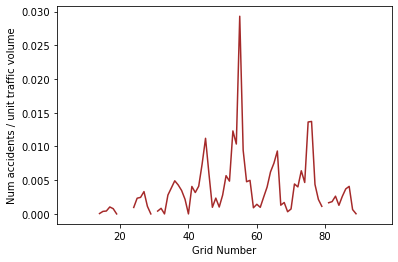

In [30]:
norm_vol = grid_box_df.copy()
norm_vol['Normalized Num Accidents'] = norm_vol['Num Accidents']/norm_vol['Avg Vol']
acc_num = norm_vol['Normalized Num Accidents']
acc_num.plot(color = 'brown'); plt.ylabel("Num accidents / unit traffic volume")
plt.show()

Interpretation: The maximum number of accidents is located in the downtown commercial core, where a great amount of people and things are most concentrated and the congestion is likely to be worst. So, although this grid area does not have the highest volume or speed, it makes sense that so many vehicles in close proximity to each other increases the likelihood of accidents.

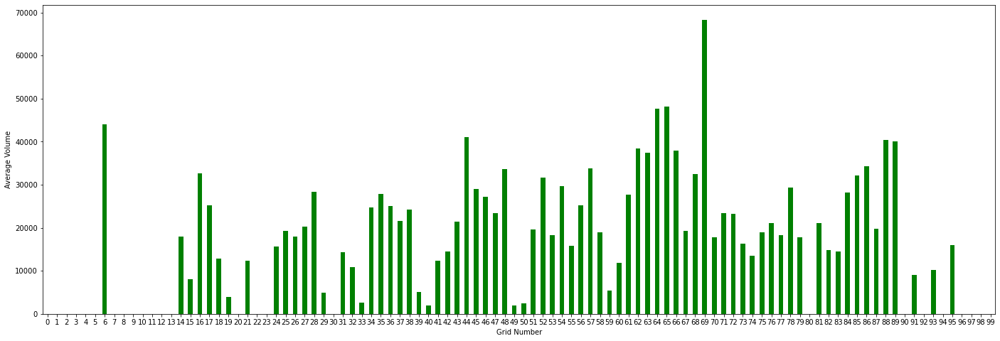

In [31]:
grid_box_df['Avg Vol'].plot(kind = 'bar', figsize=(24,8), color = 'green', rot = 0)
plt.ylabel("Average Volume"); plt.show()

In [32]:
grid_num_max_accidents = grid_box_df['Num Accidents'].argmax()
grid_num_max_volume = grid_box_df['Avg Vol'].argmax()
print("The maximum number of accidents occurs in grid number", grid_num_max_accidents)
print("The maximum traffic volume occurs in grid number", grid_num_max_volume)

The maximum number of accidents occurs in grid number 55
The maximum traffic volume occurs in grid number 69


The highest traffic volume is located in the grid with the Queen Elizabeth II Highway, which is known to be extremely busy and takes much of the traffic from downtown. This matches the findings here.

# Number of Accidents by Day

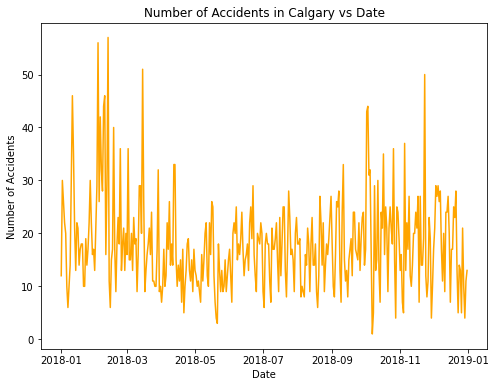

In [33]:
accident_info = weather_and_accidents_city.copy()
num_accidents_vs_days = accident_info.plot(x = 'Date', y = 'Number of Accidents', legend = None, figsize = (8,6), color = 'orange')
num_accidents_vs_days.set_ylabel('Number of Accidents')
num_accidents_vs_days.set_title('Number of Accidents in Calgary vs Date')
plt.show()

# Number of Accidents vs Temperature

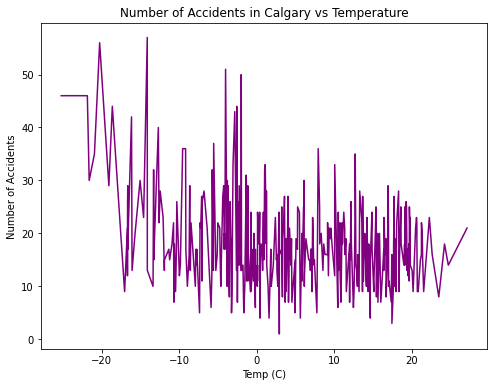

In [34]:
accident_info = accident_info.sort_values('Temp (C)')
num_accidents_vs_temp = accident_info.plot(x = 'Temp (C)', y = 'Number of Accidents', legend = None, figsize = (8,6), color = 'purple')
num_accidents_vs_temp.set_ylabel('Number of Accidents')
num_accidents_vs_temp.set_title('Number of Accidents in Calgary vs Temperature')
plt.show()

# Number of Accidents vs Visibility

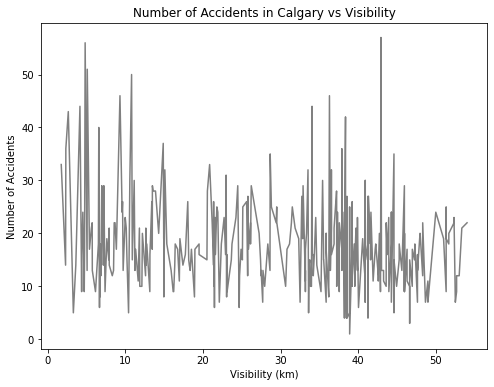

In [35]:
accident_info = accident_info.sort_values('Visibility (km)')
num_accidents_vs_vis = accident_info.plot(x = 'Visibility (km)', y = 'Number of Accidents', legend = None, figsize = (8,6), color = 'grey')
num_accidents_vs_vis.set_ylabel('Number of Accidents')
num_accidents_vs_vis.set_title('Number of Accidents in Calgary vs Visibility')

plt.show()

# Temperature and Visibility

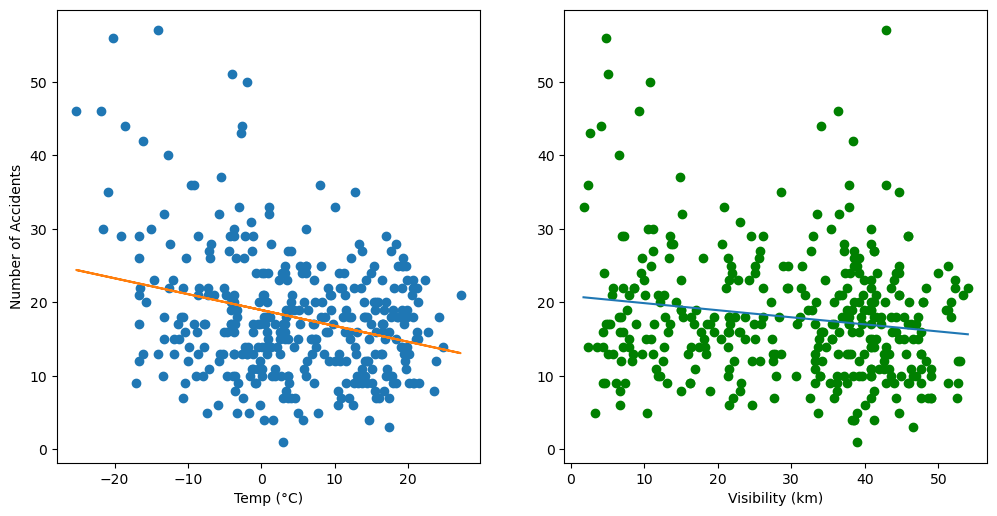

In [36]:
plt.figure(figsize=(12, 6), dpi=100); plt.subplot(1, 2, 1)
plt.plot(accident_info['Temp (C)'], accident_info['Number of Accidents'],'o')
m, b = np.polyfit(accident_info['Temp (C)'], accident_info['Number of Accidents'], 1)
plt.plot(accident_info['Temp (C)'], m*accident_info['Temp (C)'] + b)
plt.ylabel('Number of Accidents'); plt.xlabel('Temp (°C)'); plt.subplot(1, 2, 2)
plt.plot(accident_info['Visibility (km)'], accident_info['Number of Accidents'],'o', color = 'green')
m2, b = np.polyfit(accident_info['Visibility (km)'], accident_info['Number of Accidents'], 1)
plt.plot(accident_info['Visibility (km)'], m2*accident_info['Visibility (km)'] + b); plt.xlabel('Visibility (km)')
plt.show()

In [37]:
print('Number of accidents decreases by approximately', round(m,4), 'accidents per degree C')
print('Number of accidents decreases by approximately', round(m2,4), 'accidents per km of visibility')

Number of accidents decreases by approximately -0.2158 accidents per degree C
Number of accidents decreases by approximately -0.0963 accidents per km of visibility


After examining this info, one can see that both visibility and temperature clearly affect the number of accidents. Generally, on days with better conditions, there were fewer accidents. For example, on day 2018-01-10, with a low temperature of -21.625 C and fairly low visibility of 10.588 km, there was high number of accidents of 30.

Number of Accidents Above and Below 0 °C

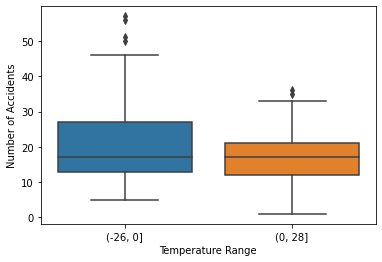

In [38]:
bin = [-26, 0, 28]
above_below_zero = weather_and_accidents_city.copy()
above_below_zero['Temperature Range']= pd.cut(above_below_zero['Temp (C)'], bin)
bp = sns.boxplot(y = 'Number of Accidents', x = 'Temperature Range', data = above_below_zero)

# Number of Accidents vs Average Speed Limit

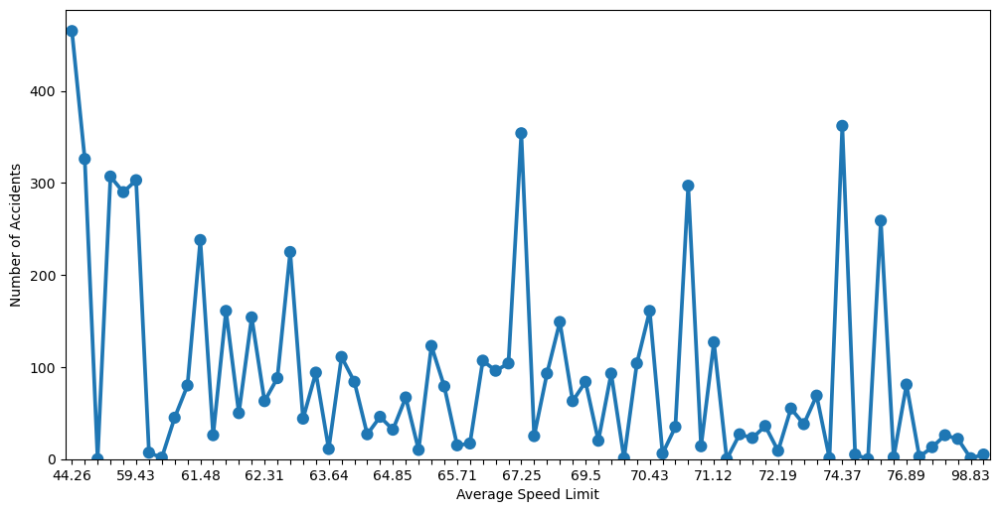

It is important to note that this data does not account for residential speed limits (50 km/h)


In [39]:
grid_box_speed = grid_box_df.copy()
grid_box_speed = grid_box_speed.sort_values('Avg Speed Limit')
plt.figure(figsize=(12, 6), dpi=100)
e = sns.pointplot(data = grid_box_speed, x = 'Avg Speed Limit', y = 'Num Accidents', ci = None)
e.set_ylim(ymin=0)
e.set_ylabel('Number of Accidents')
e.set_xlabel('Average Speed Limit')
for i, label in enumerate(e.get_xticklabels()):
    if i % 5 == 0: 
        label.set_visible(True)
    else:
        label.set_visible(False)
plt.show(e)
print('It is important to note that this data does not account for residential speed limits (50 km/h)')

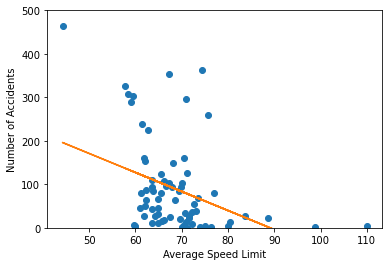

In [40]:
sa = grid_box_df.dropna()
plt.plot(sa['Avg Speed Limit'], sa['Num Accidents'],'o')
m, b = np.polyfit(sa['Avg Speed Limit'], sa['Num Accidents'], 1)
plt.ylim(0,500); plt.ylabel("Number of Accidents"); plt.xlabel("Average Speed Limit")
plt.plot(sa['Avg Speed Limit'], m*sa['Avg Speed Limit'] + b)
plt.show()

There is a negative relationship between number of accidents and average speed.

# Number of Accidents for Speed Limit Intervals

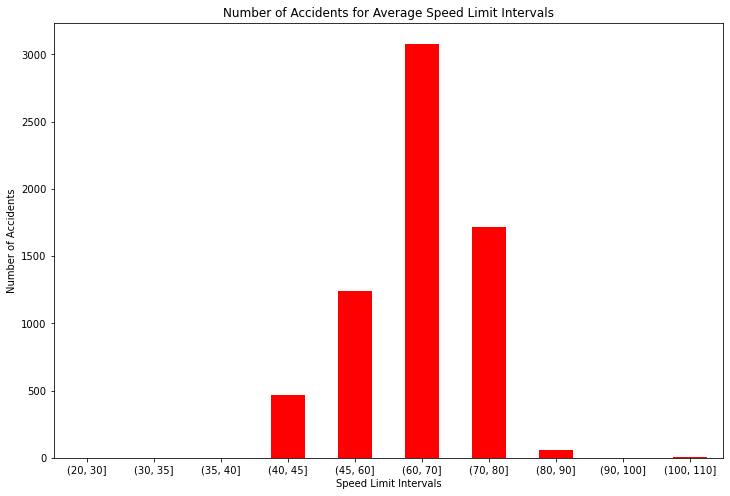

In [41]:
grid_box_speed = grid_box_df.copy()
grid_box_speed['binned'] = pd.cut(grid_box_speed['Avg Speed Limit'], [20,30,35,40,45,60,70,80,90,100,110])
grid_box_speed = grid_box_speed.groupby('binned').sum()
grid_box_speed['Num Accidents'].plot(kind = 'bar', figsize=(12,8), color = 'red', rot = 0)
plt.xlabel('Speed Limit Intervals')
plt.ylabel('Number of Accidents')
plt.title('Number of Accidents for Average Speed Limit Intervals')
plt.show()

# Number of Accidents vs Cameras

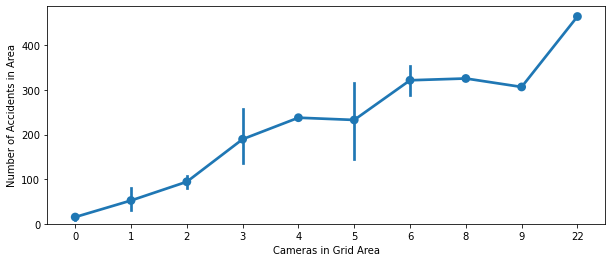

In [42]:
grid_box_cam = grid_box_df.copy()
plt.figure(figsize=(10, 4))
a = sns.pointplot(data = grid_box_cam, x = 'Num Cameras', y = 'Num Accidents')
a.set_ylim(ymin=0)
a.set_ylabel('Number of Accidents in Area')
a.set_xlabel('Cameras in Grid Area'); plt.show(a)

# Number of Accidents vs Traffic Signals

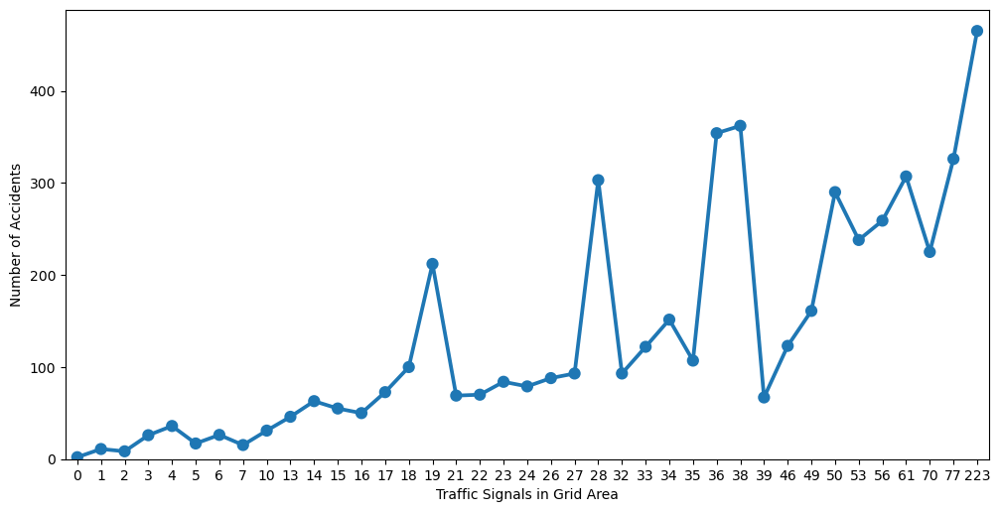

In [43]:
grid_box_signals = grid_box_df.copy()
grid_box_signals = grid_box_cam.sort_values('Num Signals')
plt.figure(figsize=(12, 6), dpi=100)
b = sns.pointplot(data = grid_box_signals, x = 'Num Signals', y = 'Num Accidents', ci = None); b.set_ylim(ymin=0)
b.set_ylabel('Number of Accidents'); b.set_xlabel('Traffic Signals in Grid Area'); plt.show(b)

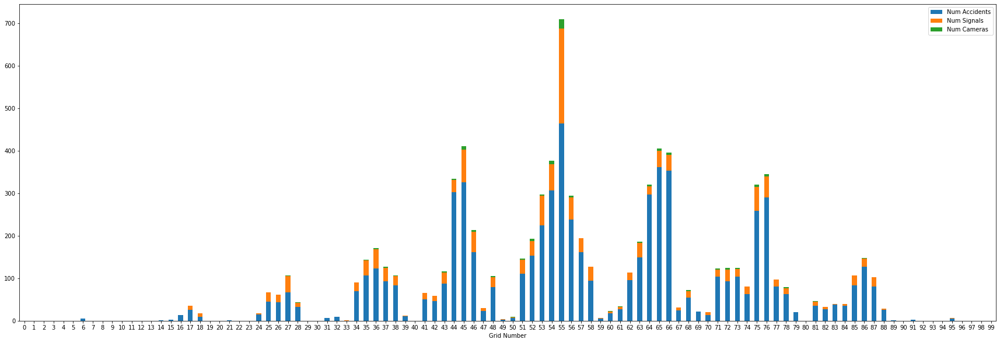

In [44]:
histdata = grid_box_df[['Num Accidents','Num Signals','Num Cameras']]
histdata.plot(kind = 'bar', stacked = True, figsize = (30, 10), rot = 0)
plt.show()

# Number of Accidents vs Traffic Signs

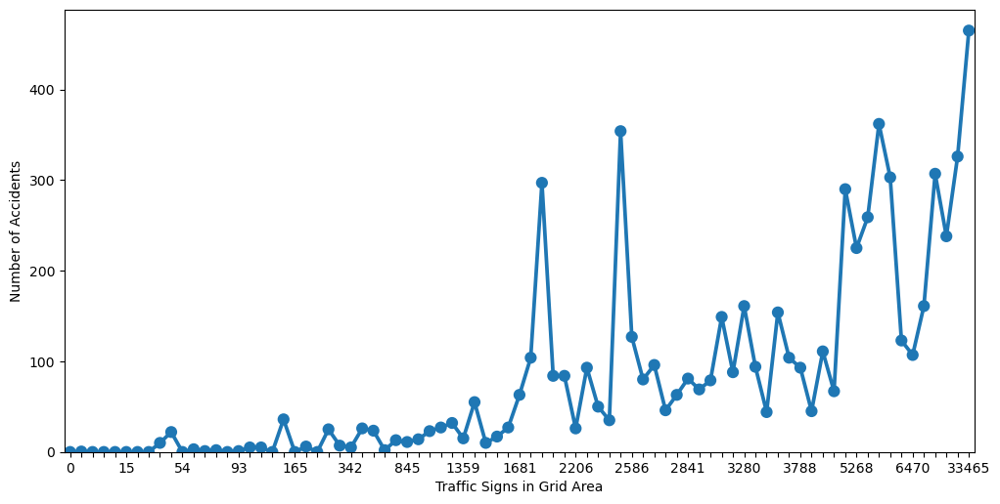

In [45]:
grid_box_signs = grid_box_df.copy()
grid_box_signs = grid_box_signs.sort_values('Num Signs')
plt.figure(figsize=(12, 6), dpi=100)
c = sns.pointplot(data = grid_box_signs, x = 'Num Signs', y = 'Num Accidents', ci = None); c.set_ylim(ymin=0)
c.set_ylabel('Number of Accidents'); c.set_xlabel('Traffic Signs in Grid Area')
for i, label in enumerate(c.get_xticklabels()):
    if i % 5 == 0: 
        label.set_visible(True)
    else:
        label.set_visible(False)
plt.show(c)

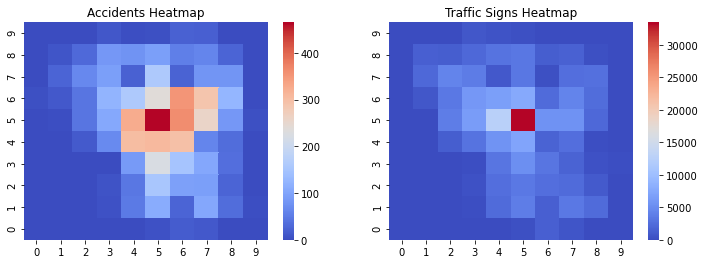

In [46]:
acc_data = grid_box_df['Num Accidents']
plt.subplot(1, 2, 1)
acc_data = pd.DataFrame(np.reshape(acc_data.values,(10,10)))
acc_data = acc_data.T; acc_data = acc_data.iloc[::-1] # Transpose and flip columns
sns.heatmap(acc_data, cmap = 'coolwarm')
plt.title('Accidents Heatmap')
sign_data = grid_box_df['Num Signs']
plt.subplot(1, 2, 2)
sign_data = pd.DataFrame(np.reshape(sign_data.values,(10,10)))
sign_data = sign_data.T; sign_data = sign_data.iloc[::-1]
fig = sns.heatmap(sign_data, cmap = 'coolwarm').get_figure()
fig.set_figwidth(12)
plt.title('Traffic Signs Heatmap')
plt.show()

There is a significant positive correlation between number of accidents and cameras, signals, and signs. It is difficult to say this is a causation relationship. It is likely the result of city efforts to mitigate amount of accidents in areas known to be prone to high accident rates.

# Number of Accidents vs Traffic Volume

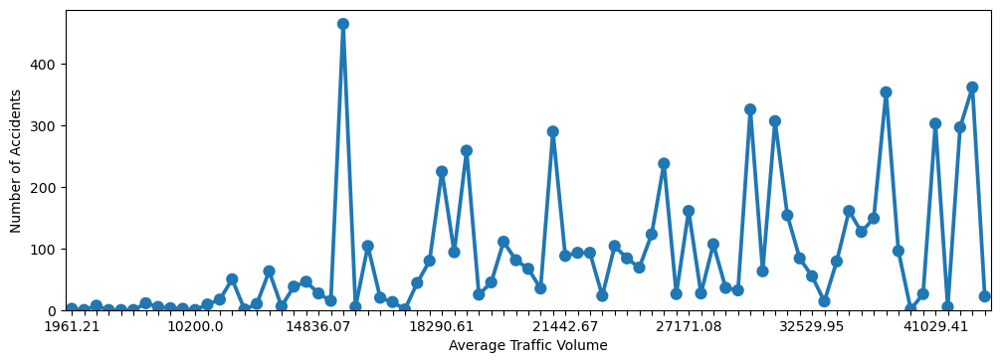

In [47]:
grid_box_vol = grid_box_df.copy()
grid_box_vol = grid_box_vol.sort_values('Avg Vol')
plt.figure(figsize=(12, 4), dpi=100)
d = sns.pointplot(data = grid_box_vol, x = 'Avg Vol', y = 'Num Accidents', ci = None); d.set_ylim(ymin=0)
d.set_ylabel('Number of Accidents'); d.set_xlabel('Average Traffic Volume')
for i, label in enumerate(d.get_xticklabels()):
    if i % 10 == 0: 
        label.set_visible(True)
    else:
        label.set_visible(False)
plt.show(d)

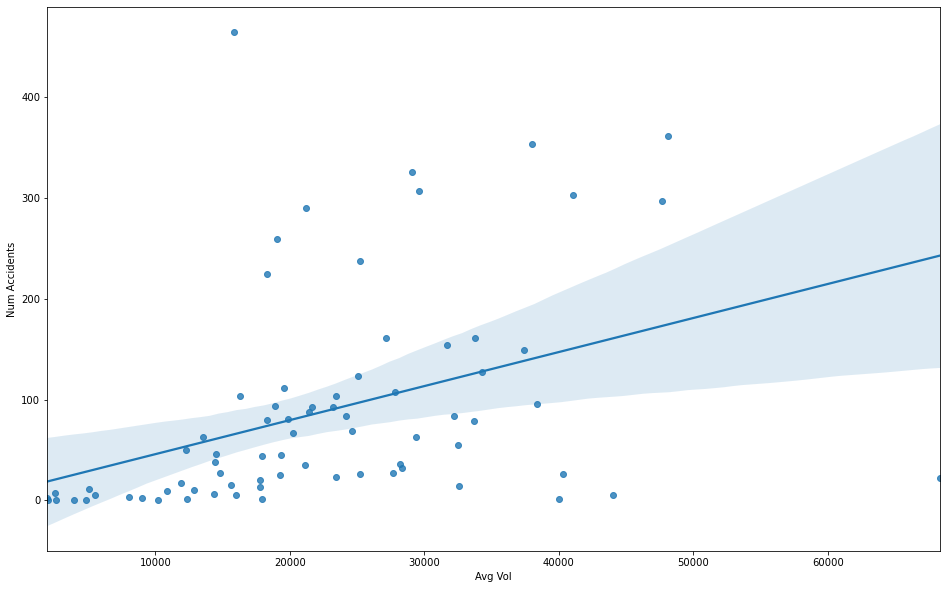

In [48]:
grid_box_vol = grid_box_df.copy()
fig, ax = plt.subplots(figsize=(16,10))
ax = sns.regplot(x = 'Avg Vol', y = 'Num Accidents', data = grid_box_vol)

We can conclude that there is an important positive connection between number of accidents and average volume.

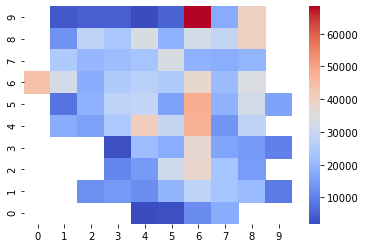

In [49]:
vol_data = grid_box_df['Avg Vol']
vol_data = pd.DataFrame(np.reshape(vol_data.values,(10,10)))
vol_data = vol_data.T; vol_data = vol_data.iloc[::-1]
sns.heatmap(vol_data, cmap ='coolwarm')

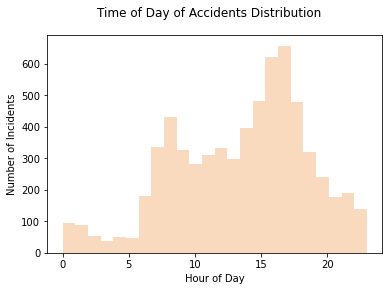

In [50]:
df_accidents_3 = df_accidents.copy()#['START_DT'] = pd.to_datetime(df_accidents_2['START_DT']).dt.date
df_accidents_3['START_DT'] = pd.to_datetime(df_accidents_3['START_DT']).dt.hour
df_accidents_3.head()
dist = sns.distplot(df_accidents_3['START_DT'], bins = 24, kde = False, color = 'sandybrown')
plt.suptitle('Time of Day of Accidents Distribution')
dist.set(ylabel = 'Number of Incidents', xlabel = 'Hour of Day')
plt.show()

The highest number of accidents is close to rush hour.

# Spearman Correlations and Probability Values

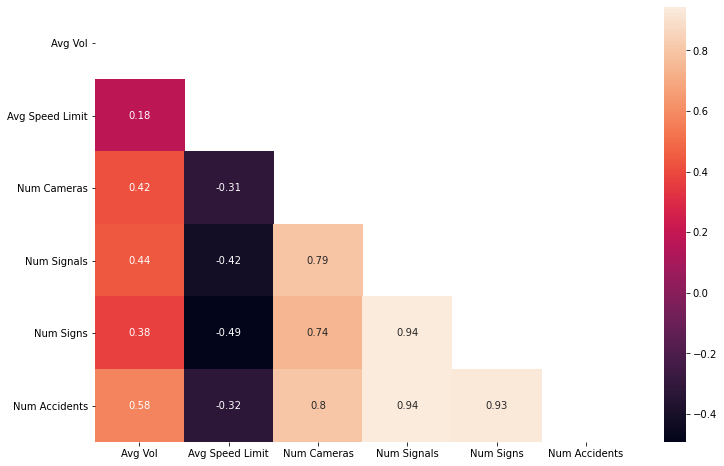

In [51]:
features = grid_box_df[['Avg Vol','Avg Speed Limit','Num Cameras','Num Signals','Num Signs','Num Accidents']]
spear = features.corr('spearman')
mask = np.triu(np.ones_like(spear, dtype=np.bool))
f, ax = plt.subplots(figsize=(12, 8))
sns.heatmap(spear, mask = mask, annot = True)
plt.show()

In [52]:
from scipy.stats import spearmanr
feats = ['Avg Vol', 'Avg Speed Limit', 'Num Cameras', 'Num Signals', 'Num Signs']
for i in feats:
    p = spearmanr(features[i], features['Num Accidents'], nan_policy = 'omit')
    print("The probability value for the " + i + " coefficient is: " + str((p[1])) )

The probability value for the Avg Vol coefficient is: 5.373952016833762e-08
The probability value for the Avg Speed Limit coefficient is: 0.0051563999985194935
The probability value for the Num Cameras coefficient is: 1.5837276326087206e-23
The probability value for the Num Signals coefficient is: 9.191169863566019e-48
The probability value for the Num Signs coefficient is: 4.233063918514421e-44


The Spearman coefficients indicate that, for number of accidents, there is a clear positive relationship between the average volume, number of cameras, number of signals, and number of signs, with average volume being most important in my opinion. The negative Spearman coefficient for average speed limit indicates, for the speed limits considered, number of accidents decreases with increased speed.

The probability values, found to be close to zero indicate that the correlations are meaningful (an uncorrelated system producing the same distribution is highly unlikely).

In [53]:
weather = weather_and_accidents_city.corr('spearman')
p = spearmanr(weather['Temp (C)'], weather['Number of Accidents'], nan_policy = 'omit')
k = spearmanr(weather['Visibility (km)'], weather['Number of Accidents'], nan_policy = 'omit')
print("Spearman rank correlation coefficient for accidents and temperature:", round(weather['Temp (C)'].iloc[0],5), ", p=",p[1])
print("Spearman rank correlation coefficient for accidents and visibility:", round(weather['Visibility (km)'].iloc[0],5), ", k=", k[1])

Spearman rank correlation coefficient for accidents and temperature: -0.16213 , p= 0.0
Spearman rank correlation coefficient for accidents and visibility: -0.12389 , k= 0.6666666666666667


This indicates that number of accidents is more strongly correlated with temperature